In [1]:
import cv2
import numpy as np
from skimage import io, morphology

def segment_image(path, blur_ksize=5, morph_disk_radius=3):
    """
    Load image from `path`, convert to gray, denoise, threshold,
    clean up and return binary mask (dtype=uint8, {0,255}).
    """
    img = io.imread(path)                      # RGB or grayscale
    if img.ndim == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    else:
        gray = img

    # 1) Denoise
    blur = cv2.GaussianBlur(gray, (blur_ksize,)*2, 0)

    # 2) Otsu threshold
    _, th = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # 3) Morphological clean-up (remove small holes & objects)
    mask = th.astype(bool)
    mask = morphology.remove_small_objects(mask, min_size=500)
    mask = morphology.remove_small_holes(mask, area_threshold=500)
    mask = morphology.binary_closing(mask, morphology.disk(morph_disk_radius))

    return (mask * 255).astype(np.uint8)

if __name__ == "__main__":
    import matplotlib.pyplot as plt
    mask = segment_image("your_image.tif")
    plt.subplot(1,2,1); plt.title("Mask"); plt.imshow(mask, cmap="gray")
    plt.subplot(1,2,2); plt.title("Overlay");
    img = io.imread("your_image.tif")
    plt.imshow(img, alpha=0.7); plt.imshow(mask, cmap="jet", alpha=0.3)
    plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/home/alex/Masters/Imaging/Spaghetti_Detection/your_image.tif'

In [10]:
import cv2, os, glob
import numpy as np

# adjust to your project root
BASE_DIR = "images/manual_segmentation_alex/data"
OUT_DIR  = "images/manual_segmentation_alex/auto_masks"
os.makedirs(OUT_DIR, exist_ok=True)



def segment(img, blur=5, min_area=200):
    # grayscale + denoise
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (blur,)*2, 0)
    # Otsu threshold
    _, th = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    # remove small noise
    cnts, _ = cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(th)
    for c in cnts:
        if cv2.contourArea(c) > min_area:
            cv2.drawContours(mask, [c], -1, 255, cv2.FILLED)
    return mask

if __name__ == "__main__":
    pattern = os.path.join(BASE_DIR, "*", "thumbnail.jpg")
    for thumb_path in glob.glob(pattern):
        img = cv2.imread(thumb_path)
        mask = segment(img)
        # build output path
        rel = os.path.relpath(thumb_path, BASE_DIR)           # e.g. "1/thumbnail.jpg"
        stem = os.path.splitext(rel)[0]                       # e.g. "1/thumbnail"
        out_path = os.path.join(OUT_DIR, stem + "_mask.png")
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        cv2.imwrite(out_path, mask)
        print(f"Written mask: {out_path}")



Written mask: images/manual_segmentation_alex/auto_masks/6/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/1/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/2/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/8/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/11/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/3/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/7/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/10/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/5/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/4/thumbnail_mask.png
Written mask: images/manual_segmentation_alex/auto_masks/9/thumbnail_mask.png


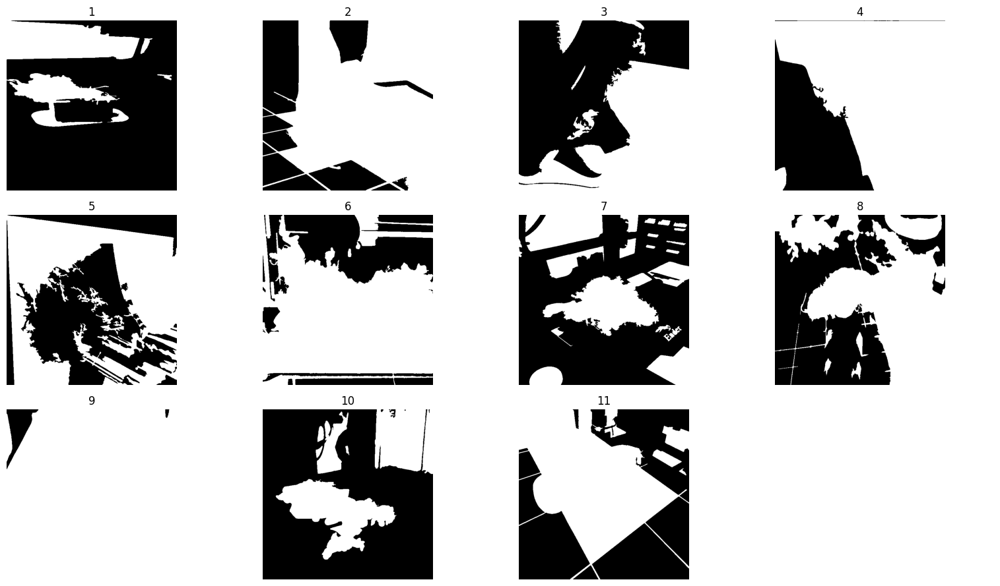

In [3]:
import glob
import matplotlib.pyplot as plt
from PIL import Image

mask_paths = sorted(
    glob.glob("images/manual_segmentation_alex/auto_masks/*/thumbnail_mask.png"),
    key=lambda p: int(p.split('/')[-2])
)

n = len(mask_paths)
cols = 4
rows = (n + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 3*rows))
for ax, p in zip(axes.flatten(), mask_paths):
    ax.imshow(Image.open(p), cmap='gray')
    ax.set_title(p.split('/')[-2])
    ax.axis('off')
for ax in axes.flatten()[n:]:
    ax.axis('off')
plt.tight_layout()
plt.show()


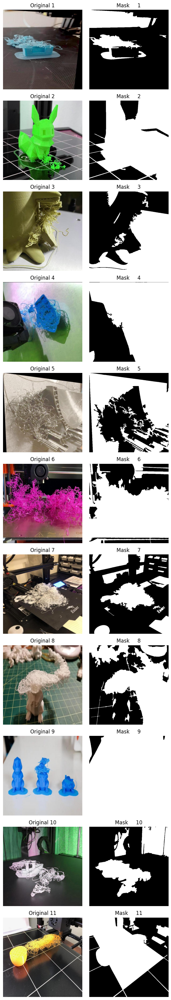

In [4]:
import glob
import os
import matplotlib.pyplot as plt
from PIL import Image

# patterns (adjust if needed)
orig_pattern = "images/manual_segmentation_alex/data/*/thumbnail.jpg"
mask_pattern = "images/manual_segmentation_alex/auto_masks/*/thumbnail_mask.png"

# collect & sort by folder number
orig_paths = sorted(
    glob.glob(orig_pattern),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)
mask_paths = sorted(
    glob.glob(mask_pattern),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)

n = len(orig_paths)
fig, axes = plt.subplots(n, 2, figsize=(6, 3 * n))

for i, (o, m) in enumerate(zip(orig_paths, mask_paths)):
    axes[i, 0].imshow(Image.open(o))
    axes[i, 0].set_title(f"Original {os.path.basename(os.path.dirname(o))}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(Image.open(m), cmap='gray')
    axes[i, 1].set_title(f"Mask     {os.path.basename(os.path.dirname(m))}")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


In [5]:
import os, glob
import cv2
import numpy as np

# — adjust to your own paths —
IMG_DIR  = "images/manual_segmentation_alex/data"
OUT_DIR  = "images/manual_segmentation_alex/auto_masks_grabcut"
os.makedirs(OUT_DIR, exist_ok=True)

def grabcut_segment(img, iter_count=5, rect_margin=10):
    h, w = img.shape[:2]
    rect = (rect_margin, rect_margin,
            w - 2*rect_margin, h - 2*rect_margin)

    # initialize mask & models
    mask = np.zeros((h, w), np.uint8)
    bgd = np.zeros((1,65), np.float64)
    fgd = np.zeros((1,65), np.float64)

    # run GrabCut
    cv2.grabCut(img, mask, rect, bgd, fgd, iter_count,
                cv2.GC_INIT_WITH_RECT)

    # pixels marked foreground or probable foreground
    fg_mask = np.where((mask==cv2.GC_FGD) |
                       (mask==cv2.GC_PR_FGD), 255, 0).astype('uint8')
    # optional cleanup
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
    fg_mask = cv2.morphologyEx(fg_mask,
                               cv2.MORPH_CLOSE, kernel, iterations=2)
    return fg_mask

if __name__ == "__main__":
    pattern = os.path.join(IMG_DIR, "*", "thumbnail.jpg")
    for thumb_path in glob.glob(pattern):
        img = cv2.imread(thumb_path)
        mask = grabcut_segment(img)

        # save mask
        rel = os.path.relpath(thumb_path, IMG_DIR)  # e.g. "1/thumbnail.jpg"
        stem = os.path.splitext(rel)[0]
        out_p = os.path.join(OUT_DIR, stem + "_gc_mask.png")
        os.makedirs(os.path.dirname(out_p), exist_ok=True)
        cv2.imwrite(out_p, mask)
        print("Saved:", out_p)


Saved: images/manual_segmentation_alex/auto_masks_grabcut/6/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/1/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/2/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/8/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/11/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/3/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/7/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/10/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/5/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/4/thumbnail_gc_mask.png
Saved: images/manual_segmentation_alex/auto_masks_grabcut/9/thumbnail_gc_mask.png


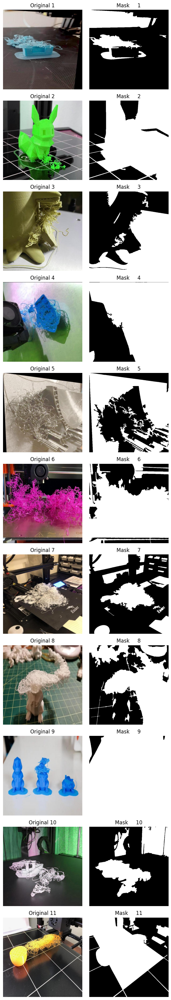

In [6]:
import glob
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# simple Otsu‐based segmentation
def segment(img, blur_ksize=5, min_area=200):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (blur_ksize,)*2, 0)
    _, th = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    # remove small specks
    cnts, _ = cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(th)
    for c in cnts:
        if cv2.contourArea(c) > min_area:
            cv2.drawContours(mask, [c], -1, 255, cv2.FILLED)
    return mask

# locate your thumbnails
thumbs = sorted(
    glob.glob("images/manual_segmentation_alex/data/*/thumbnail.jpg"),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)

n = len(thumbs)
fig, axes = plt.subplots(n, 2, figsize=(6, 3*n))

for i, tp in enumerate(thumbs):
    img = cv2.imread(tp)
    mask = segment(img)

    # show original
    axes[i,0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[i,0].set_title(f"Original {os.path.basename(os.path.dirname(tp))}")
    axes[i,0].axis("off")

    # show mask
    axes[i,1].imshow(mask, cmap="gray")
    axes[i,1].set_title(f"Mask     {os.path.basename(os.path.dirname(tp))}")
    axes[i,1].axis("off")

plt.tight_layout()
plt.show()


/tmp/ipykernel_370174/3260141549.py:21: UserWarning: Use keyword parameter `sigmas` instead of `scale_range` and `scale_range` which will be removed in version 0.17.
  vessels = frangi(gray, scale_range=(1, 5), scale_step=2)


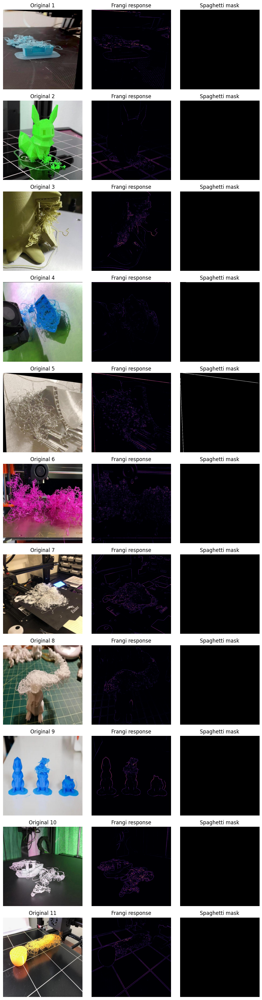

In [7]:
import glob, os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi
from skimage.morphology import remove_small_objects, skeletonize

# find your thumbnails
thumbs = sorted(
    glob.glob("images/manual_segmentation_alex/data/*/thumbnail.jpg"),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)

fig, axes = plt.subplots(len(thumbs), 3, figsize=(9, 3*len(thumbs)))

for i, tp in enumerate(thumbs):
    img = cv2.imread(tp)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) / 255.0

    # 1) Frangi vesselness to highlight thin tubular structures
    vessels = frangi(gray, scale_range=(1, 5), scale_step=2)

    # 2) threshold vesselness map
    mask = vessels > 0.2

    # 3) remove small specks
    mask = remove_small_objects(mask, min_size=500)

    # 4) (optional) skeletonize if you only want centerlines
    ske = skeletonize(mask)

    # plot
    axes[i,0].imshow(img[:,:,::-1])
    axes[i,0].set_title(f"Original {os.path.basename(os.path.dirname(tp))}")
    axes[i,0].axis("off")

    axes[i,1].imshow(vessels, cmap="magma")
    axes[i,1].set_title("Frangi response")
    axes[i,1].axis("off")

    axes[i,2].imshow(mask, cmap="gray")
    axes[i,2].set_title("Spaghetti mask")
    axes[i,2].axis("off")

plt.tight_layout()
plt.show()


/tmp/ipykernel_370174/2047385410.py:21: UserWarning: Use keyword parameter `sigmas` instead of `scale_range` and `scale_range` which will be removed in version 0.17.
  vessels = frangi(gray, scale_range=(1, 4), scale_step=1)


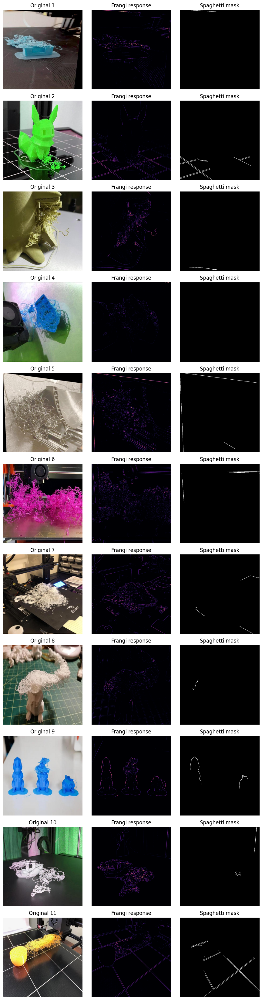

In [8]:
import glob, os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, threshold_otsu
from skimage.morphology import remove_small_objects

# find your thumbnails
thumbs = sorted(
    glob.glob("images/manual_segmentation_alex/data/*/thumbnail.jpg"),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)

fig, axes = plt.subplots(len(thumbs), 3, figsize=(9, 3*len(thumbs)))

for i, tp in enumerate(thumbs):
    img = cv2.imread(tp)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) / 255.0

    # 1) Frangi vesselness
    vessels = frangi(gray, scale_range=(1, 4), scale_step=1)

    # 2) Adaptive threshold via Otsu
    try:
        th = threshold_otsu(vessels[vessels>0])
        mask = vessels >= th
    except ValueError:
        mask = vessels > 0  # fallback if vessels is all zeros

    # 3) Clean up
    mask = remove_small_objects(mask, min_size=200)

    # display
    axes[i,0].imshow(img[:,:,::-1])
    axes[i,0].set_title(f"Original {os.path.basename(os.path.dirname(tp))}")
    axes[i,0].axis("off")

    axes[i,1].imshow(vessels, cmap="magma")
    axes[i,1].set_title("Frangi response")
    axes[i,1].axis("off")

    axes[i,2].imshow(mask, cmap="gray")
    axes[i,2].set_title("Spaghetti mask")
    axes[i,2].axis("off")

plt.tight_layout()
plt.show()


/tmp/ipykernel_370174/2698610624.py:48: UserWarning: Use keyword parameter `sigmas` instead of `scale_range` and `scale_range` which will be removed in version 0.17.
  vessels = frangi(gray, scale_range=(1,4), scale_step=1)
/tmp/ipykernel_370174/2698610624.py:12: UserWarning: Use keyword parameter `sigmas` instead of `scale_range` and `scale_range` which will be removed in version 0.17.
  vessels = frangi(gray, scale_range=(1,4), scale_step=1)
/tmp/ipykernel_370174/2698610624.py:21: FutureWarning: `rectangle` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  hor = opening(mask, rectangle(1, w//3))      # horizontal lines
/tmp/ipykernel_370174/2698610624.py:22: FutureWarning: `rectangle` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  ver = opening(mask, rectangle(h//3, 1))      # vertical lines


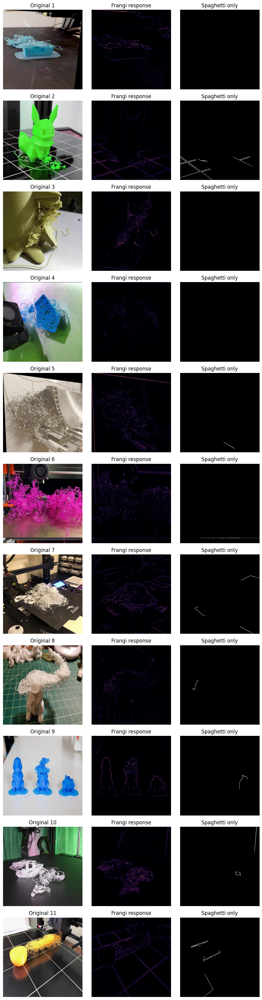

In [9]:
import glob, os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, threshold_otsu
from skimage.morphology import remove_small_objects, opening, rectangle
from skimage.measure import label, regionprops

# helper: spaghetti-only mask
def spaghetti_mask(gray):
    # 1) Frangi + Otsu
    vessels = frangi(gray, scale_range=(1,4), scale_step=1)
    th = threshold_otsu(vessels[vessels>0]) if np.any(vessels>0) else 0
    mask = vessels >= th

    # 2) remove tiny noise
    mask = remove_small_objects(mask, min_size=200)

    # 3) remove long straight lines (grid):
    h, w = mask.shape
    hor = opening(mask, rectangle(1, w//3))      # horizontal lines
    ver = opening(mask, rectangle(h//3, 1))      # vertical lines
    mask = mask & ~(hor | ver)

    # 4) filter out any remaining components that are too large/straight:
    lbl = label(mask)
    clean = np.zeros_like(mask)
    for prop in regionprops(lbl):
        minr,minc,maxr,maxc = prop.bbox
        # keep only blobs smaller than, say, 1/3 image width & height
        if (maxc-minc) < w/3 and (maxr-minr) < h/3:
            clean[lbl == prop.label] = 1

    return clean

# gather thumbnails
thumbs = sorted(
    glob.glob("images/manual_segmentation_alex/data/*/thumbnail.jpg"),
    key=lambda p: int(os.path.basename(os.path.dirname(p)))
)

# plot original / frangi / final
fig, axes = plt.subplots(len(thumbs), 3, figsize=(9, 3*len(thumbs)))
for i, tp in enumerate(thumbs):
    img = cv2.imread(tp)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) / 255.0

    vessels = frangi(gray, scale_range=(1,4), scale_step=1)
    mask = spaghetti_mask(gray)

    axes[i,0].imshow(img[:,:,::-1])
    axes[i,0].set_title(f"Original {os.path.basename(os.path.dirname(tp))}")
    axes[i,0].axis("off")

    axes[i,1].imshow(vessels, cmap="magma")
    axes[i,1].set_title("Frangi response")
    axes[i,1].axis("off")

    axes[i,2].imshow(mask, cmap="gray")
    axes[i,2].set_title("Spaghetti only")
    axes[i,2].axis("off")

plt.tight_layout()
plt.show()


Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/6/thumbnail_spaghetti_mask.png


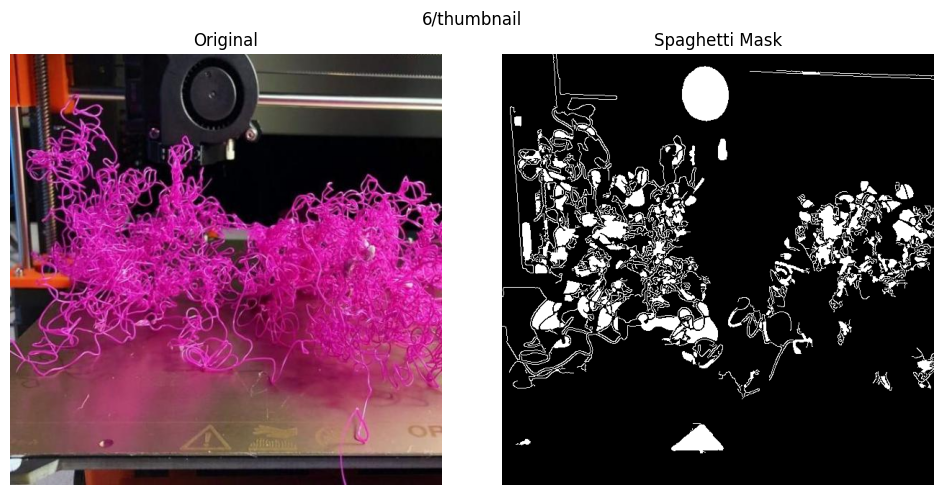

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/1/thumbnail_spaghetti_mask.png


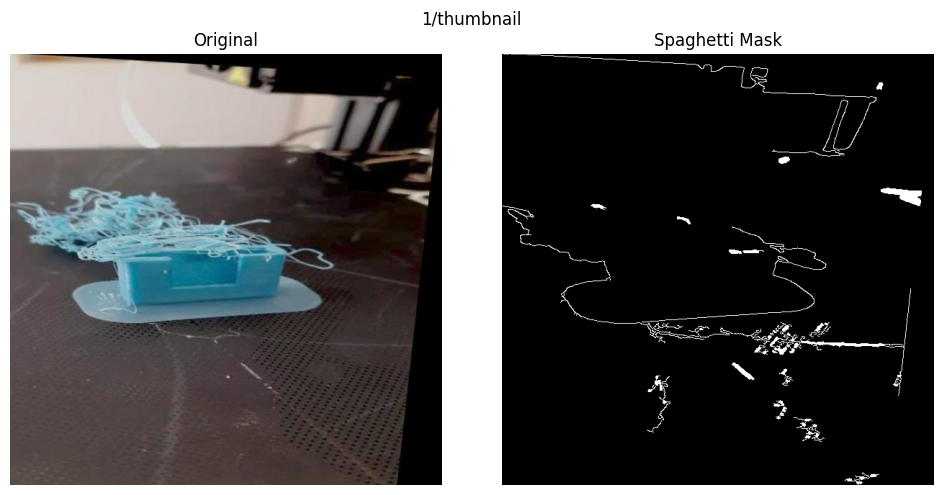

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/2/thumbnail_spaghetti_mask.png


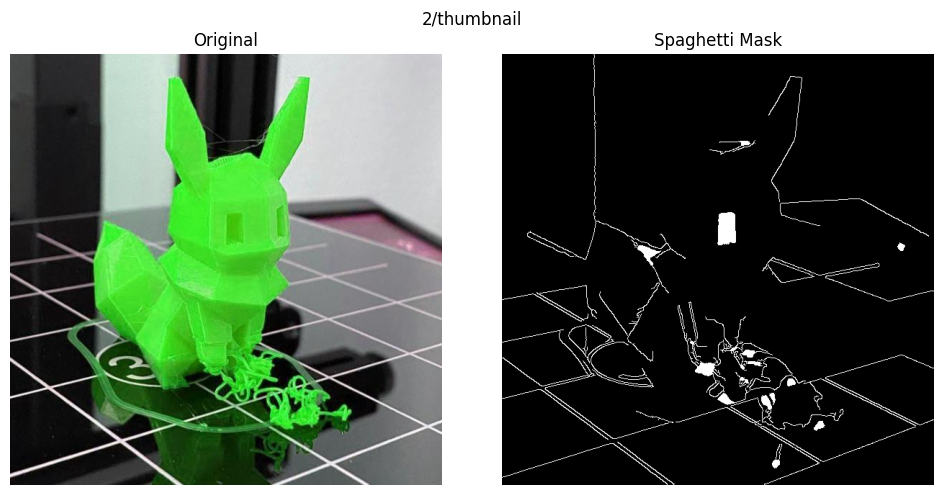

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/8/thumbnail_spaghetti_mask.png


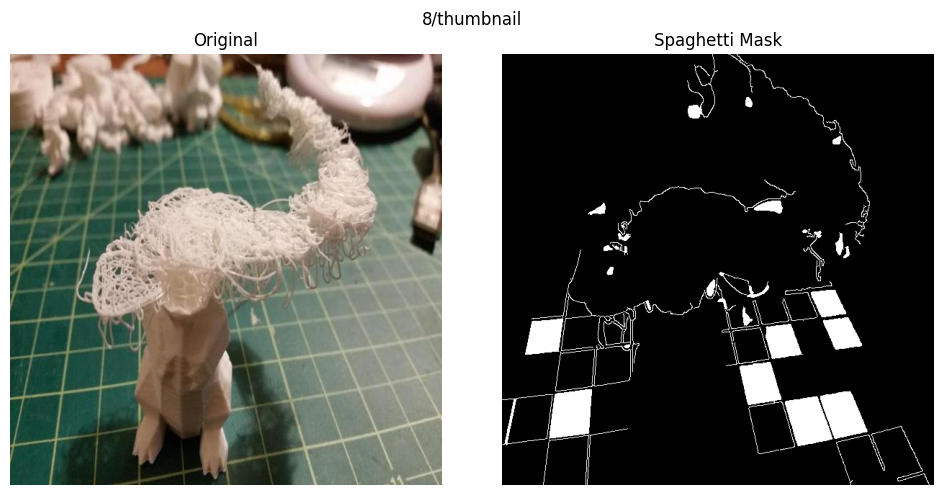

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/11/thumbnail_spaghetti_mask.png


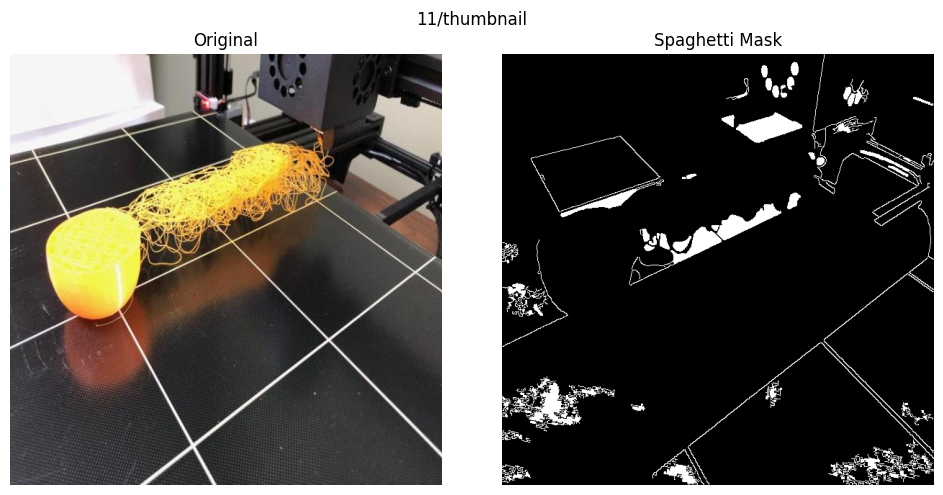

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/3/thumbnail_spaghetti_mask.png


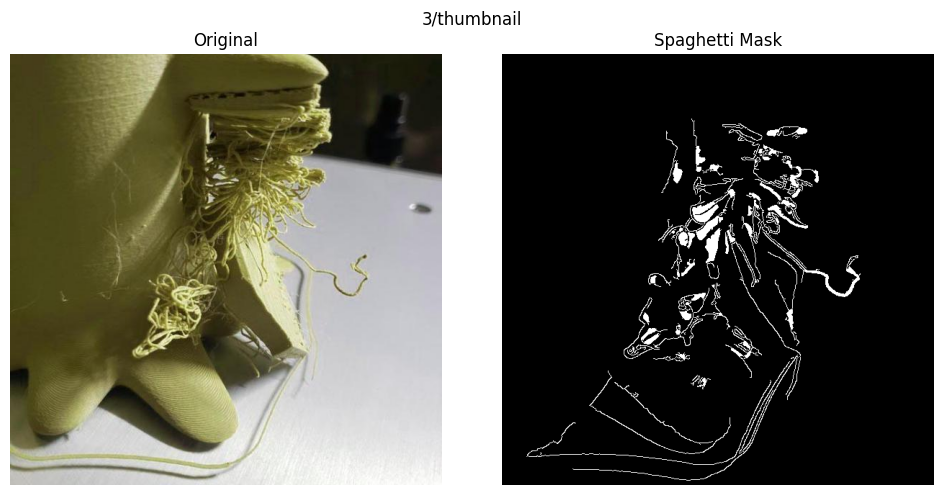

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/7/thumbnail_spaghetti_mask.png


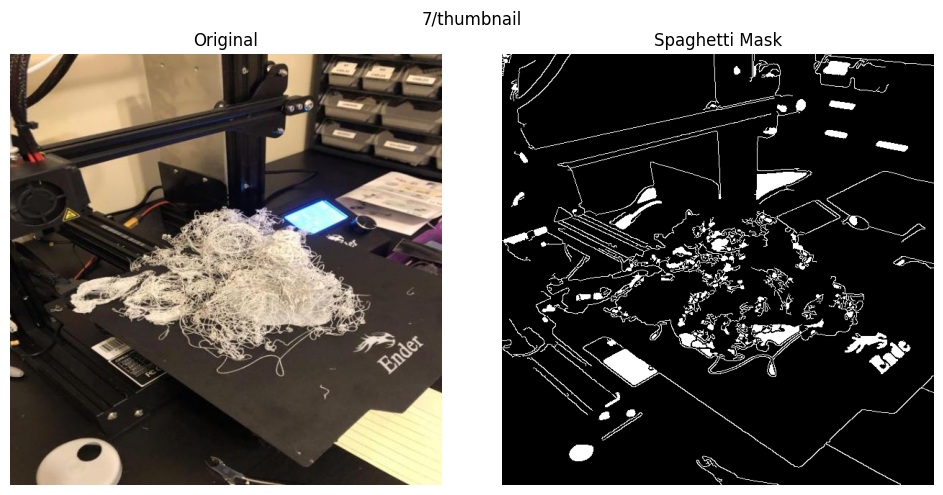

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/10/thumbnail_spaghetti_mask.png


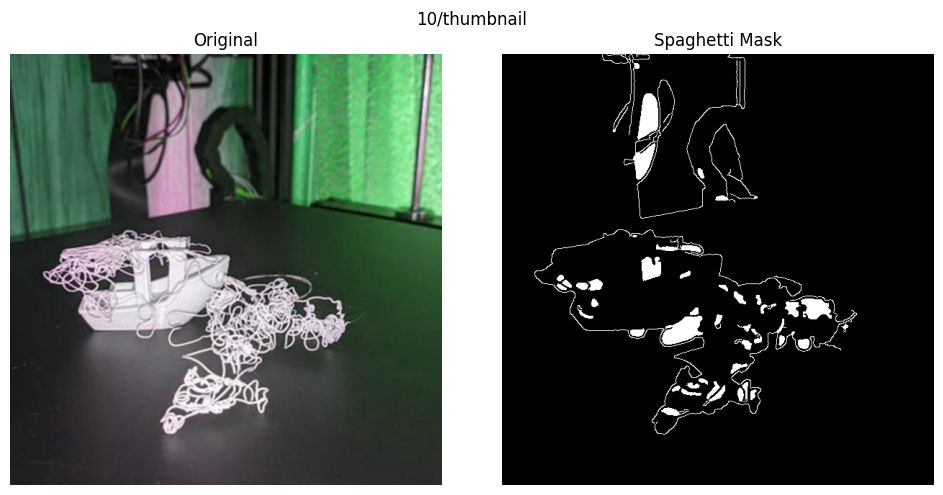

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/5/thumbnail_spaghetti_mask.png


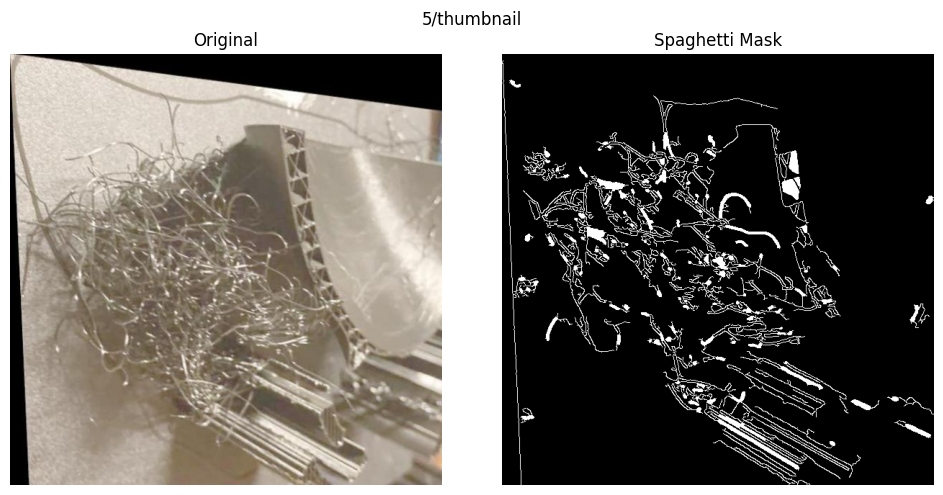

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/4/thumbnail_spaghetti_mask.png


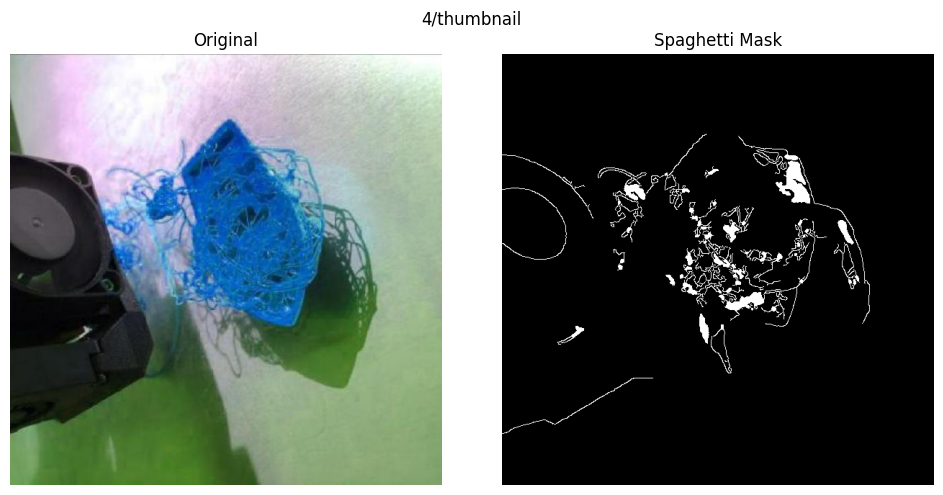

Written spaghetti mask: images/manual_segmentation_alex/auto_masks_spaghetti/9/thumbnail_spaghetti_mask.png


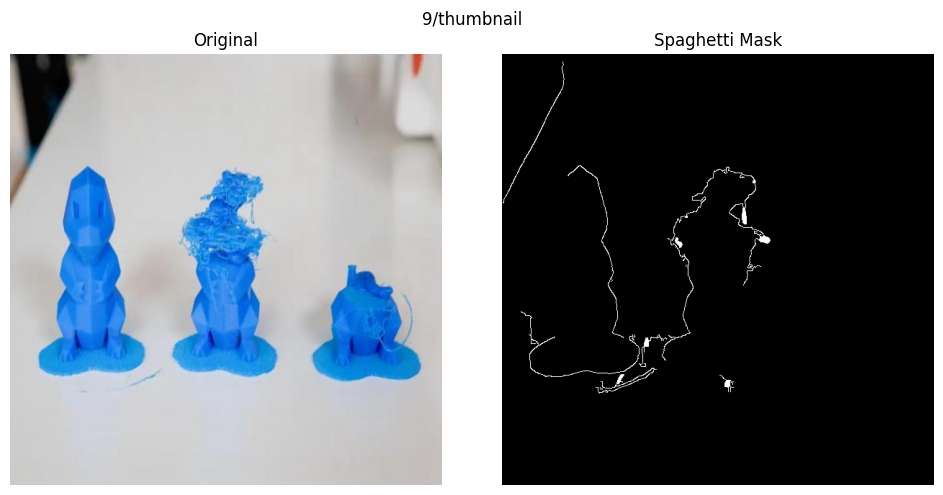

In [12]:
import cv2
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

# Set up paths
BASE_DIR = "images/manual_segmentation_alex/data"
OUT_DIR  = "images/manual_segmentation_alex/auto_masks_spaghetti"
os.makedirs(OUT_DIR, exist_ok=True)

def segment_spaghetti(img, blur=3, min_area=50, max_area=5000, edge_thresh1=50, edge_thresh2=150):
    # Convert to grayscale and equalize histogram
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)

    # Blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (blur, blur), 0)

    # Edge detection
    edges = cv2.Canny(blurred, edge_thresh1, edge_thresh2)

    # Find contours
    cnts, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create empty mask
    mask = np.zeros_like(gray)

    # Draw contours within area range
    for c in cnts:
        area = cv2.contourArea(c)
        if min_area < area < max_area:
            cv2.drawContours(mask, [c], -1, 255, cv2.FILLED)

    return mask

def show_side_by_side(original, mask, title=""):
    # Convert BGR to RGB for display
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)

    # Plot original and mask side-by-side
    plt.figure(figsize=(10, 5))
    plt.suptitle(title, fontsize=12)
    plt.subplot(1, 2, 1)
    plt.imshow(original_rgb)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap="gray")
    plt.title("Spaghetti Mask")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    pattern = os.path.join(BASE_DIR, "*", "thumbnail.jpg")

    for thumb_path in glob.glob(pattern):
        img = cv2.imread(thumb_path)
        if img is None:
            print(f"Failed to load: {thumb_path}")
            continue

        mask = segment_spaghetti(img)

        # Save the mask
        rel = os.path.relpath(thumb_path, BASE_DIR)
        stem = os.path.splitext(rel)[0]
        out_path = os.path.join(OUT_DIR, stem + "_spaghetti_mask.png")
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        cv2.imwrite(out_path, mask)
        print(f"Written spaghetti mask: {out_path}")

        # Show the results
        show_side_by_side(img, mask, title=stem)


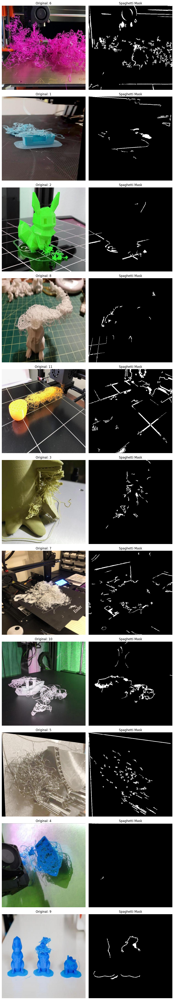

In [16]:
import cv2
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

# Set up path
BASE_DIR = "images/manual_segmentation_alex/data"

def segment_spaghetti_complex(img, blur=3, min_area=30, max_area=3000):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)
    blurred = cv2.GaussianBlur(gray, (blur, blur), 0)

    # Laplacian to detect texture-rich areas
    laplacian = cv2.Laplacian(blurred, cv2.CV_64F)
    laplacian_abs = cv2.convertScaleAbs(laplacian)
    _, thresh = cv2.threshold(laplacian_abs, 25, 255, cv2.THRESH_BINARY)

    cnts, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(gray)
    for c in cnts:
        area = cv2.contourArea(c)
        if min_area < area < max_area:
            cv2.drawContours(mask, [c], -1, 255, cv2.FILLED)

    return mask


if __name__ == "__main__":
    pattern = os.path.join(BASE_DIR, "*", "thumbnail.jpg")
    paths = glob.glob(pattern)

    num_images = len(paths)
    fig, axs = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

    if num_images == 1:
        axs = np.array([axs])  # handle 1-row case

    for i, thumb_path in enumerate(paths):
        img = cv2.imread(thumb_path)
        if img is None:
            print(f"Failed to load: {thumb_path}")
            continue

        mask = segment_spaghetti_complex(img)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        axs[i, 0].imshow(img_rgb)
        axs[i, 0].set_title(f"Original: {os.path.basename(os.path.dirname(thumb_path))}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(mask, cmap="gray")
        axs[i, 1].set_title("Spaghetti Mask")
        axs[i, 1].axis("off")

    plt.tight_layout()
    plt.show()


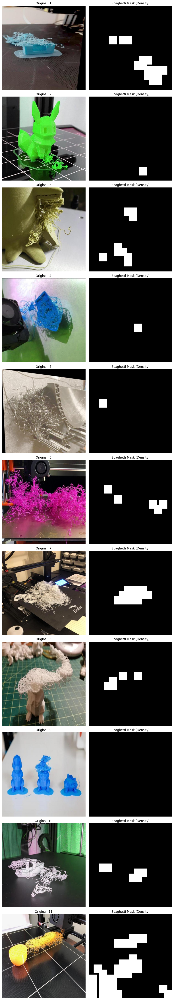

In [22]:
import cv2
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

# Path to images
BASE_DIR = "images/manual_segmentation_alex/data"

# --- Preprocessing ---

def sharpen_image(img):
    kernel = np.array([[0, -1, 0],
                       [-1, 5,-1],
                       [0, -1, 0]])
    return cv2.filter2D(img, -1, kernel)

# --- Spaghetti Detection ---

def contour_density_mask(gray_img, window_ratio=0.1, stride_ratio=0.06, density_thresh=25, min_perimeter=20):
    height, width = gray_img.shape
    window = int(min(height, width) * window_ratio)
    stride = int(min(height, width) * stride_ratio)
    mask = np.zeros_like(gray_img)

    for y in range(0, height - window + 1, stride):
        for x in range(0, width - window + 1, stride):
            roi = gray_img[y:y+window, x:x+window]
            edges = cv2.Canny(roi, 50, 150)
            cnts, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            # Filter out very small contours by arc length
            cnts = [c for c in cnts if cv2.arcLength(c, closed=True) > min_perimeter]

            if len(cnts) >= density_thresh:
                mask[y:y+window, x:x+window] = 255
    return mask


# --- Visualization ---

def show_results(images, masks, titles):
    n = len(images)
    fig, axs = plt.subplots(n, 2, figsize=(10, 5 * n))
    if n == 1:
        axs = np.array([axs])
    for i in range(n):
        axs[i, 0].imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        axs[i, 0].set_title(f"Original: {titles[i]}")
        axs[i, 0].axis("off")
        axs[i, 1].imshow(masks[i], cmap="gray")
        axs[i, 1].set_title("Spaghetti Mask (Density)")
        axs[i, 1].axis("off")
    plt.tight_layout()
    plt.show()

# --- Main ---

if __name__ == "__main__":
    pattern = os.path.join(BASE_DIR, "*", "thumbnail.jpg")
    paths = sorted(glob.glob(pattern), key=lambda p: int(os.path.basename(os.path.dirname(p))))

    images, masks, titles = [], [], []

    for thumb_path in paths:
        img = cv2.imread(thumb_path)
        if img is None:
            print(f"Failed to load: {thumb_path}")
            continue

        sharp = sharpen_image(img)
        gray = cv2.cvtColor(sharp, cv2.COLOR_BGR2GRAY)
        mask = contour_density_mask(gray)

        images.append(img)
        masks.append(mask)
        titles.append(os.path.basename(os.path.dirname(thumb_path)))

    show_results(images, masks, titles)


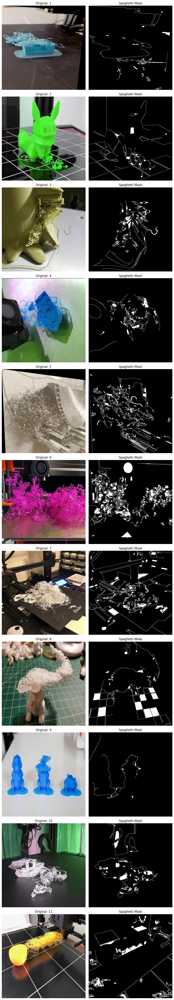

In [23]:
import cv2
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

# Set up path
BASE_DIR = "images/manual_segmentation_alex/data"

# --- Segmentation Function ---

def segment_spaghetti(img, blur=3, min_area=50, max_area=5000, edge_thresh1=50, edge_thresh2=150):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)
    blurred = cv2.GaussianBlur(gray, (blur, blur), 0)
    edges = cv2.Canny(blurred, edge_thresh1, edge_thresh2)
    cnts, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(gray)
    for c in cnts:
        area = cv2.contourArea(c)
        if min_area < area < max_area:
            cv2.drawContours(mask, [c], -1, 255, cv2.FILLED)
    return mask

# --- Visualization ---

def show_all_side_by_side(images, masks, titles):
    n = len(images)
    fig, axs = plt.subplots(n, 2, figsize=(10, 5 * n))
    if n == 1:
        axs = np.array([axs])  # handle single image case

    for i in range(n):
        axs[i, 0].imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        axs[i, 0].set_title(f"Original: {titles[i]}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(masks[i], cmap="gray")
        axs[i, 1].set_title("Spaghetti Mask")
        axs[i, 1].axis("off")

    plt.tight_layout()
    plt.show()

# --- Main ---

if __name__ == "__main__":
    pattern = os.path.join(BASE_DIR, "*", "thumbnail.jpg")

    # Sort by numeric folder name if possible
    paths = sorted(glob.glob(pattern), key=lambda p: int(os.path.basename(os.path.dirname(p))))

    images, masks, titles = [], [], []

    for thumb_path in paths:
        img = cv2.imread(thumb_path)
        if img is None:
            print(f"Failed to load: {thumb_path}")
            continue

        mask = segment_spaghetti(img)
        title = os.path.basename(os.path.dirname(thumb_path))

        images.append(img)
        masks.append(mask)
        titles.append(title)

    show_all_side_by_side(images, masks, titles)
